In [1]:
import numpy as np
import cv2
from skimage import color
import os
from os import listdir
from skimage import img_as_float
from skimage import exposure
import scipy.ndimage
import re
from PIL import Image
import matplotlib.pyplot as plt

In [14]:
from IPython import display
def cv2_imshow(a):
    """A replacement for cv2.imshow() for use in Jupyter notebooks.
    Args:
    a : np.ndarray. shape (N, M) or (N, M, 1) is an NxM grayscale image. shape
      (N, M, 3) is an NxM BGR color image. shape (N, M, 4) is an NxM BGRA color
      image.
    """
    a = a.clip(0, 255).astype('uint8')
    # cv2 stores colors as BGR; convert to RGB
    if a.ndim == 3:
        if a.shape[2] == 4:
            a = cv2.cvtColor(a, cv2.COLOR_BGRA2RGBA)
        else:
            a = cv2.cvtColor(a, cv2.COLOR_BGR2RGB)
    display.display(Image.fromarray(a))

In [2]:
# global variables
cutoff_margin = 10
blur_size = (7, 7)
QuantumRange = 65535
GammaGlobal = 2.15

In [3]:
def sorted_nicely( l ): 
    convert = lambda text: int(text) if text.isdigit() else text 
    alphanum_key = lambda key: [ convert(c) for c in re.split('([0-9]+)', key) ] 
    return sorted(l, key = alphanum_key)

def normalize(image, low=2, high=99):
    float = img_as_float(image)
    p_low, p_high = np.percentile(float, (low, high))
    rescale = exposure.rescale_intensity(float, in_range=(p_low, p_high))
    normalized = rescale * QuantumRange/rescale.max()
    return normalized

def adjust_gamma(image, gamma):
    inv_gamma = 1.0 / gamma
    table = ((np.arange(0, (QuantumRange + 1)) / QuantumRange) ** inv_gamma) * QuantumRange
    table = table.astype(np.uint16)
    return table[image.astype(np.uint16)]

def adjust_channel(channel, mininum, gamma):
    normalized = channel / QuantumRange
    exponent = np.clip((mininum * normalized.astype(float) ** (-1)), 0, QuantumRange)
    output = exponent * QuantumRange
    clipped = np.clip(output, 0, QuantumRange)
    adjusted_channel = adjust_gamma(clipped, gamma)
    return adjusted_channel

def recompile_image(r_channel, g_channel, b_channel, gamma_subtract):
    image = (cv2.merge([r_channel.astype(np.uint16), g_channel.astype(np.uint16), b_channel.astype(np.uint16)]))
    image = adjust_gamma(image.astype(np.uint16), GammaGlobal)
    image = image.astype(np.uint16) - gamma_subtract
    image = np.clip(image, np.amin(image), np.amax(image))
    recompiled_image = cv2.normalize(image, None, alpha=0, beta=QuantumRange, norm_type=cv2.NORM_MINMAX)
    return recompiled_image

def autolevel_image(image):
    print(' Correcting levels...')
    image_gray = color.rgb2gray(image.astype(np.uint16))

    blackpoint = np.amin(image_gray) * QuantumRange
    whitepoint = np.amax(image_gray) * QuantumRange
    autolevel_mean = 100 * np.mean(image) / QuantumRange
    autolevel_midrange = 0.5
    autolevel_gamma = np.log(autolevel_mean / 100) / np.log(autolevel_midrange)

    image_hsv = color.rgb2hsv(image.astype(np.uint16))
    h_channel,s_channel,v_channel = cv2.split(image_hsv)

    v_channel = v_channel * QuantumRange
    v_channel = np.clip(v_channel, blackpoint, whitepoint)
    v_channel = cv2.normalize(v_channel, None, alpha=0, beta=QuantumRange, norm_type=cv2.NORM_MINMAX)
    v_channel = v_channel / QuantumRange

    output_hsv = cv2.merge((h_channel, s_channel, v_channel))
    autoleveled_image = color.hsv2rgb(output_hsv) * QuantumRange
    autoleveled_image = adjust_gamma(autoleveled_image.astype(np.uint16), autolevel_gamma)

    return autoleveled_image

def autocolor_image(image):
    print(' Correcting colors...')
    image_gray = color.rgb2gray(image.astype(np.uint16))
    r_channel, g_channel, b_channel = cv2.split(image)

    neutral_gray = np.mean(image_gray)

    r_mean = (np.mean(r_channel) / QuantumRange)
    r_ratio = neutral_gray / r_mean
    g_mean = (np.mean(g_channel) / QuantumRange)
    g_ratio = neutral_gray / g_mean
    b_mean = (np.mean(b_channel) / QuantumRange)
    b_ratio = neutral_gray / b_mean

    r_colorcorrected = np.clip((r_channel * b_ratio), 0, QuantumRange) # prevents clipping
    r_colorcorrected = normalize(r_colorcorrected, 0.5, 99.5)
    g_colorcorrected = np.clip((g_channel * g_ratio), 0, QuantumRange)
    g_colorcorrected = normalize(g_colorcorrected, 0.5, 99.5)
    b_colorcorrected = np.clip((b_channel * r_ratio), 0, QuantumRange)
    b_colorcorrected = normalize(b_colorcorrected, 0.5, 99.5)

    autocolored_image = (cv2.merge([r_colorcorrected.astype(np.uint16), g_colorcorrected.astype(np.uint16), b_colorcorrected.astype(np.uint16)]))

    return autocolored_image
 
def remove_noise(image, aggressiveness=7):
    normalized = image/QuantumRange
    inverted = 1-normalized
    tmp = scipy.ndimage.convolve(inverted, np.ones((3,3)), mode='constant')
    out = np.logical_and(tmp >= aggressiveness, inverted).astype(np.float32)
    reverted = 1-out
    unnormalized = reverted * QuantumRange
    return unnormalized

def dust_removal(infrared_image, inverted_image, r_channel):
    print(' Removing dust...')
    normalized_infrared = normalize(infrared_image, 2, 99)
    normalized_red = normalize(r_channel, 2, 99)

    c = normalized_infrared/((normalized_red.astype('float')+1)/(QuantumRange+1))
    divided = c*(c < QuantumRange)+QuantumRange*np.ones(np.shape(c))*(c > QuantumRange)

    ret, threshold = cv2.threshold(divided,(QuantumRange-QuantumRange/1),QuantumRange,cv2.THRESH_BINARY)
    inverted = QuantumRange - threshold
    
    kernel = np.ones((5,5),np.uint8)
    noise_removed = cv2.morphologyEx(inverted, cv2.MORPH_OPEN, kernel)

    mask = cv2.dilate(noise_removed, kernel, iterations = 1)

    mask = QuantumRange - mask
    
    #gray_mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)
    #gray_mask = cv2.filter2D(mask, cv2.CV_8U)

    #radius = 10
    #flags = cv2.INPAINT_TELEA #or use cv2.INPAINT_NS
    #dust_removed = cv2.inpaint(inverted_image.astype(np.float32), mask, radius, flags=flags)

    #return dust_removed
    return mask


In [4]:
filepath = '/Users/vmitchell/GitHub/signynts-darkroom-script/input/2023-10-15 KodakU400 (4).tif'

In [171]:
layered, negative_input = cv2.imreadmulti(filepath, [], cv2.IMREAD_UNCHANGED)

#inverted_image, r_channel = negative_inversion(negative_input[0])

image_input = negative_input[0]

r_input, g_input, b_input = cv2.split(image_input)

# def find_gamma(image_input, cutoff_margin):
image_crop = image_input[cutoff_margin:-cutoff_margin, cutoff_margin:-cutoff_margin]
image_blur = cv2.blur(image_crop, blur_size)
r_blur, g_blur, b_blur = cv2.split(image_blur)

r_min = np.amin(r_blur) / QuantumRange
r_max = np.amax(r_blur) / QuantumRange
g_min = np.amin(g_blur) / QuantumRange
g_max = np.amax(g_blur) / QuantumRange
b_min = np.amin(b_blur) / QuantumRange
b_max = np.amax(b_blur) / QuantumRange

gamma_subtract = ((b_min/b_max) ** (1/GammaGlobal)) * QuantumRange * 0.95
gamma_for_r = np.log(r_max/r_min) / np.log(b_max/b_min)
gamma_for_g = np.log(g_max/g_min) / np.log(b_max/b_min)
gamma_for_b = 1

r_adjusted = adjust_channel(r_input, r_min, gamma_for_r)
g_adjusted = adjust_channel(g_input, g_min, gamma_for_g)
b_adjusted = adjust_channel(b_input, b_min, gamma_for_b)

inverted_negative = recompile_image(r_adjusted, g_adjusted, b_adjusted, gamma_subtract)


# Assuming array1 is already defined and is a 3-dimensional array (height, width, channels)
height, width, channels = inverted_negative.shape

# Create a new image with the specified color
film_color = np.full((height, width, channels), [255*256, 241*256, 192*256], dtype=np.uint16) # BGR


divided = (inverted_negative/film_color)*QuantumRange
#autoleveled_negative = autolevel_image(divided)
autocolored_negative = autocolor_image(divided)

image = divided

 Correcting colors...


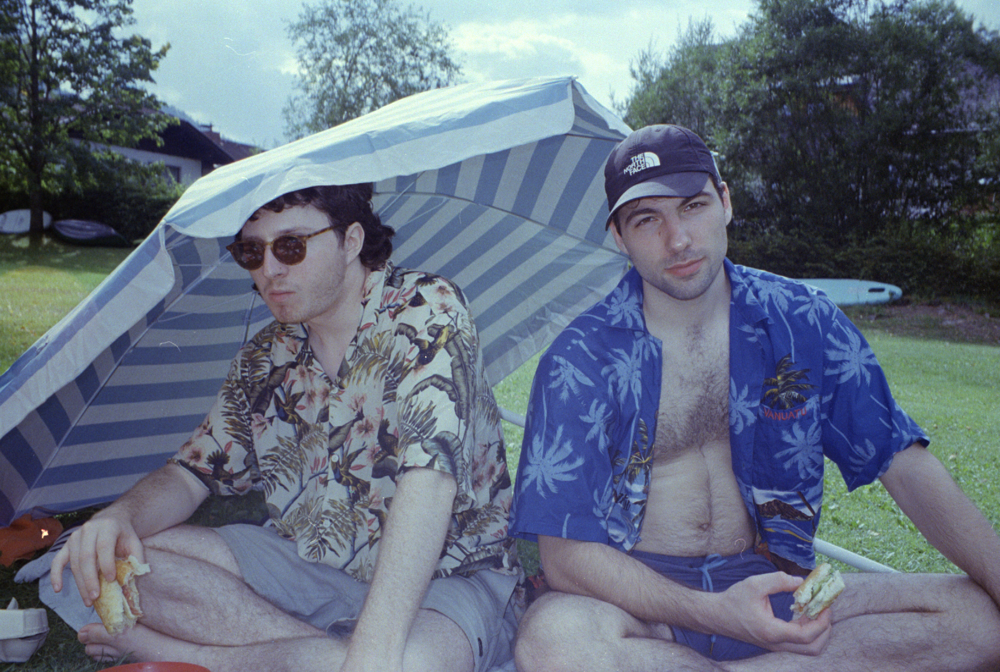

In [172]:
#normalized_image1 = cv2.normalize(film_color, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
cv2_imshow(divided/256)

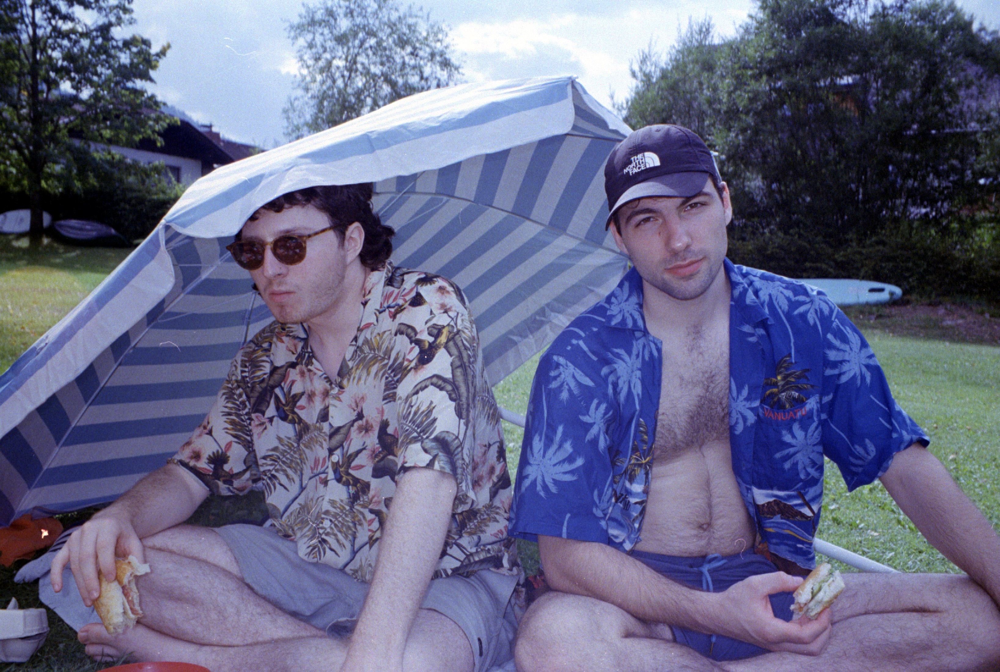

In [173]:
#normalized_image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
cv2_imshow(autocolored_negative/256)